In [1]:
from bs4 import BeautifulSoup as bs
import re
import time
from urllib.request import urlopen
import json
from pandas.io.json import json_normalize
import pandas as pd, numpy as np
import os
import requests
import datetime
import nltk
from nltk.tokenize.treebank import TreebankWordDetokenizer
from nltk.tokenize import sent_tokenize
nltk.download('punkt')
import string
import spacy
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from textwrap import wrap
from nltk.text import Text

# NLTK
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet as wn

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# PreProcessing


In [2]:
df = pd.read_csv("aftercovid.csv")
df

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,26-Nov-20,A freehold semi-detached house at 61 Jalan Kel...,20,Nov,"['freehold', 'semi', 'detached', 'house', '61'...",freehold semi detached house 61 jalan kelawar ...,2020-11-26
1,23-Nov-20,"A 4,822 sq ft unit at luxury condo, Nassim Par...",20,Nov,"['4', '822', 'sq', 'ft', 'unit', 'luxury', 'na...",4 822 sq ft unit luxury nassim park residences...,2020-11-23
2,22-Nov-20,vinz said:\r\nWrote to HDB in OCT 2020 to get ...,20,Nov,"['vinz', 'wrote', 'hdb', 'oct', '2020', 'get',...",vinz wrote hdb oct 2020 get confirmation eligi...,2020-11-22
3,18-Nov-20,Wrote to HDB in OCT 2020 to get a confirmation...,20,Nov,"['wrote', 'hdb', 'oct', '2020', 'get', 'confir...",wrote hdb oct 2020 get confirmation eligibilit...,2020-11-18
4,29-Oct-20,Depends on if you need the space or not ?\r\nT...,20,Oct,"['depends', 'need', 'space', 'rules', 'changed...",depends need space rules changed last year usa...,2020-10-29
...,...,...,...,...,...,...,...
15453,30-Nov-20,A four-storey shophouse at 11 New Bridge Road ...,20,Nov,"['four', 'storey', 'shophouse', '11', 'new', '...",four storey shophouse 11 new bridge road marke...,2020-11-30
15454,29-Nov-20,"The price of 1 bedder in D19 for example, pric...",20,Nov,"['price', '1', 'bedder', 'd19', 'example', 'pr...",price 1 bedder d19 example price around 750 85...,2020-11-29
15455,25-Nov-20,angrymonster said:\n324k to 397k\n\nStack 123 ...,20,Nov,"['angrymonster', '324k', '397k', 'stack', '123...",angrymonster 324k 397k stack 123 top floor sta...,2020-11-25
15456,25-Nov-20,Is it true that top floor units are taller in ...,20,Nov,"['true', 'top', 'floor', 'units', 'taller', 'h...",true top floor units taller height floor plan ...,2020-11-25


# clean contractions

In [3]:
# Dictionary of English Contractions
contractions_dict = { "ain't": "are not","'s":" is","aren't": "are not",
                     "can't": "cannot","can't've": "cannot have",
                     "'cause": "because","could've": "could have","couldn't": "could not",
                     "couldn't've": "could not have", "didn't": "did not","doesn't": "does not",
                     "don't": "do not","hadn't": "had not","hadn't've": "had not have",
                     "hasn't": "has not","haven't": "have not","he'd": "he would",
                     "he'd've": "he would have","he'll": "he will", "he'll've": "he will have",
                     "how'd": "how did","how'd'y": "how do you","how'll": "how will",
                     "I'd": "I would", "I'd've": "I would have","I'll": "I will",
                     "I'll've": "I will have","I'm": "I am","I've": "I have", "isn't": "is not",
                     "it'd": "it would","it'd've": "it would have","it'll": "it will",
                     "it'll've": "it will have", "let's": "let us","ma'am": "madam",
                     "mayn't": "may not","might've": "might have","mightn't": "might not", 
                     "mightn't've": "might not have","must've": "must have","mustn't": "must not",
                     "mustn't've": "must not have", "needn't": "need not",
                     "needn't've": "need not have","o'clock": "of the clock","oughtn't": "ought not",
                     "oughtn't've": "ought not have","shan't": "shall not","sha'n't": "shall not",
                     "shan't've": "shall not have","she'd": "she would","she'd've": "she would have",
                     "she'll": "she will", "she'll've": "she will have","should've": "should have",
                     "shouldn't": "should not", "shouldn't've": "should not have","so've": "so have",
                     "that'd": "that would","that'd've": "that would have", "there'd": "there would",
                     "there'd've": "there would have", "they'd": "they would",
                     "they'd've": "they would have","they'll": "they will",
                     "they'll've": "they will have", "they're": "they are","they've": "they have",
                     "to've": "to have","wasn't": "was not","we'd": "we would",
                     "we'd've": "we would have","we'll": "we will","we'll've": "we will have",
                     "we're": "we are","we've": "we have", "weren't": "were not","what'll": "what will",
                     "what'll've": "what will have","what're": "what are", "what've": "what have",
                     "when've": "when have","where'd": "where did", "where've": "where have",
                     "who'll": "who will","who'll've": "who will have","who've": "who have",
                     "why've": "why have","will've": "will have","won't": "will not",
                     "won't've": "will not have", "would've": "would have","wouldn't": "would not",
                     "wouldn't've": "would not have","y'all": "you all", "y'all'd": "you all would",
                     "y'all'd've": "you all would have","y'all're": "you all are",
                     "y'all've": "you all have", "you'd": "you would","you'd've": "you would have",
                     "you'll": "you will","you'll've": "you will have", "you're": "you are",
                     "you've": "you have"}

# Regular expression for finding contractions
contractions_re=re.compile('(%s)' % '|'.join(contractions_dict.keys()))

# Function for expanding contractions
def expand_contractions(text,contractions_dict=contractions_dict):
    def replace(match):
        return contractions_dict[match.group(0)]
    return contractions_re.sub(replace, text)


# Remove non-English words

# remove punc 
df['clean_text']  = df['text'].map(lambda x: re.sub("[^A-Za-z0-9]+"," ", str(x)))
# lower case
df['clean_text']  = df['clean_text'].apply(lambda x: x.lower())
# tokenize
df['clean_text']  = [word_tokenize(row) for row in df['clean_text']]

# remove stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use'])
def remove_stopwords(text):
    return [w for w in text if w not in stop_words]
df['clean_text']  = df['clean_text'].apply(lambda x: remove_stopwords(x))


# Expanding Contractions in the reviews
df["join_clean_text"]=df["join_clean_text"].apply(lambda x:expand_contractions(x))

df.head()

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,26-Nov-20,A freehold semi-detached house at 61 Jalan Kel...,20,Nov,"[freehold, semi, detached, house, 61, jalan, k...",freehold semi detached house 61 jalan kelawar ...,2020-11-26
1,23-Nov-20,"A 4,822 sq ft unit at luxury condo, Nassim Par...",20,Nov,"[4, 822, sq, ft, unit, luxury, condo, nassim, ...",4 822 sq ft unit luxury nassim park residences...,2020-11-23
2,22-Nov-20,vinz said:\r\nWrote to HDB in OCT 2020 to get ...,20,Nov,"[vinz, said, wrote, hdb, oct, 2020, get, confi...",vinz wrote hdb oct 2020 get confirmation eligi...,2020-11-22
3,18-Nov-20,Wrote to HDB in OCT 2020 to get a confirmation...,20,Nov,"[wrote, hdb, oct, 2020, get, confirmation, eli...",wrote hdb oct 2020 get confirmation eligibilit...,2020-11-18
4,29-Oct-20,Depends on if you need the space or not ?\r\nT...,20,Oct,"[depends, need, space, rules, changed, last, y...",depends need space rules changed last year usa...,2020-10-29


# lemmatization

In [4]:
# # spacy for lemmatization
# import spacy
# import scipy.sparse
# from spacy.lang.en import English
# nlp = spacy.load("en_core_web_sm")

# def lemmatization(text, allowed_postags=['NOUN']): 
#     doc = nlp(' '.join(text)) 
#     text_out = [token.lemma_ for token in doc if token.pos_ in allowed_postags]
#     return text_out

# df['clean_text'] = df['clean_text'].apply(lambda x: lemmatization(x))
# df['clean_text']  = [word_tokenize(row) for row in df['clean_text']]
# data_lemmatized = df['clean_text'].tolist()


from nltk.util import ngrams
def make_bigrams(texts):
    texts = [" ".join(w) for w in ngrams(texts, 2)]
    return texts

df['clean_text'] = df['clean_text'].apply(lambda x: make_bigrams(x))

data_lemmatized = df['clean_text'].tolist()

In [5]:
df.head()

,Date,text,Year,Month,clean_text,join_clean_text,real_Date
0,26-Nov-20,A freehold semi-detached house at 61 Jalan Kel...,20,Nov,"[freehold semi, semi detached, detached house,...",freehold semi detached house 61 jalan kelawar ...,2020-11-26
1,23-Nov-20,"A 4,822 sq ft unit at luxury condo, Nassim Par...",20,Nov,"[4 822, 822 sq, sq ft, ft unit, unit luxury, l...",4 822 sq ft unit luxury nassim park residences...,2020-11-23
2,22-Nov-20,vinz said:\r\nWrote to HDB in OCT 2020 to get ...,20,Nov,"[vinz said, said wrote, wrote hdb, hdb oct, oc...",vinz wrote hdb oct 2020 get confirmation eligi...,2020-11-22
3,18-Nov-20,Wrote to HDB in OCT 2020 to get a confirmation...,20,Nov,"[wrote hdb, hdb oct, oct 2020, 2020 get, get c...",wrote hdb oct 2020 get confirmation eligibilit...,2020-11-18
4,29-Oct-20,Depends on if you need the space or not ?\r\nT...,20,Oct,"[depends need, need space, space rules, rules ...",depends need space rules changed last year usa...,2020-10-29


# Bertopic

In [6]:
# pip install python-dev-tools --user --upgrade


In [7]:
# !pip3 install bertopic
# pip install bertopic --user

In [8]:
# pip install 'bertopic[gensim]'

In [9]:
# !pip3 install 'bertopic[visualization]'

In [10]:
# df_full['month_year'] = df_full['month_year'].astype(str)
# df_full['month_year'] = pd.to_datetime(df_full['month_year'])

In [11]:
# text = df.lemmatized.to_list()
# dates = df['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

In [12]:
from bertopic import BERTopic

**Wordcloud**

In [13]:
#wordcloud code
import matplotlib.pyplot as plt

def create_wordcloud(topic_model, topic):
    text = {word: value for word, value in topic_model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()


In [14]:
df["join_clean_text"][1:20]

1     4 822 sq ft unit luxury nassim park residences...
2     vinz wrote hdb oct 2020 get confirmation eligi...
3     wrote hdb oct 2020 get confirmation eligibilit...
4     depends need space rules changed last year usa...
5     polar bear king pls quote real life listings s...
6     lowzeewee quick search propertyguru asking pri...
7     polar bear king 2 5 3 times distance bv mrt le...
8     probably go unit nearest walking distance mrt ...
9     dream catcher probably go unit nearest walking...
10    hi everyone covid looking move outside singapo...
11    momoksan wont surprised understand way respons...
12    nee lee yes totally agree agent knew budget br...
13    honest agent recently bought resale flat prett...
14    nee lee recently bought resale flat pretty bad...
15    nee lee recently bought resale flat pretty bad...
16    nee lee recently bought resale flat pretty bad...
17    nee lee recently bought resale flat pretty bad...
18    nee lee recently bought resale flat pretty

**Unigram**

In [15]:
# # topic_model_uni = BERTopic(n_gram_range=(1,1), verbose=True)
# topic_model_uni = BERTopic( verbose=True)
# topics_uni, _ = topic_model_uni.fit_transform(df["join_clean_text"].to_list())

In [16]:
# freq_uni = topic_model_uni.get_topic_info()
# freq_uni.head(10)

In [17]:
# topic_nr_uni = freq_uni.iloc[6]["Topic"] # select a frequent topic
# topic_model_uni.get_topic(topic_nr_uni)

In [18]:
# # Show word cloud
# create_wordcloud(topic_model_uni,topic=-1)

In [19]:
# create_wordcloud(topic_model_uni, topic=0)


**Trying different embedding models**

In [20]:
# pip install tensorflow_hub

Universal Sentence Encoder (USE)

In [21]:
text = df["join_clean_text"].to_list()
text

['freehold semi detached house 61 jalan kelawar market 7 84 million knight frank singapore appointed estate sole marketing agent sale two storey house sits plot 3 100 sq ft nine metre frontage jalan kelawar asking price translates land rate 2 500 psf edgeprop sg property ne arezone utm medium utm campaign forumposting',
 '4 822 sq ft unit luxury nassim park residences put market price tag upwards 13 98 million 2 899 psf edgeprop sg property ne arezone utm medium utm campaign forumposting',
 'vinz wrote hdb oct 2020 get confirmation eligibility apply bto current resale flat without grant taking keys new flat mop current resale flat without grant ding dong conclusion 7th oct 2020 email hdb checking whether couple bought resale flat without grant year 2018 jan eligible apply coming bto november 2020 probable completion date 2024 reason write course mentioned new flats ready existing flat mop online forum discussion know along matter grant grant existing hdb resale flat application next bt

In [22]:
# import tensorflow_hub
# embedding_model = tensorflow_hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

# topic_model_uni_2 = BERTopic(embedding_model=embedding_model, min_topic_size=70, n_gram_range=(1,1), verbose=True)
# topics_uni_2, _ = topic_model_uni_2.fit_transform(text)

In [23]:
# freq_uni_2 = topic_model_uni_2.get_topic_info()
# freq_uni_2.head(10)

In [24]:
# # Show word cloud
# create_wordcloud(topic_model_uni_2,topic=0)

In [25]:
# create_wordcloud(topic_model_uni_2,topic=1)

**Bigram**

In [26]:
topic_model_bi = BERTopic(min_topic_size=70, n_gram_range=(2,2), verbose=True)
topics_bi, _ = topic_model_bi.fit_transform(text)

Batches:   0%|          | 0/484 [00:00<?, ?it/s]

2022-10-25 15:29:42,963 - BERTopic - Transformed documents to Embeddings
2022-10-25 15:30:05,883 - BERTopic - Reduced dimensionality
2022-10-25 15:30:07,151 - BERTopic - Clustered reduced embeddings


In [27]:
freq_bi = topic_model_bi.get_topic_info()
freq_bi["Name"][1]

'0_new launch_near mrt_resale market_mrt station'

In [28]:
freq_bi

,Topic,Count,Name
0,-1,751,-1_near mrt_resale market_west sun_10 years
1,0,13298,0_new launch_near mrt_resale market_mrt station
2,1,987,1_primary school_within 1km_primary schools_go...
3,2,344,2_fixed rate_interest rate_3m sora_interest rates
4,3,78,3_campaign forumposting_ne arezone_medium utm_...


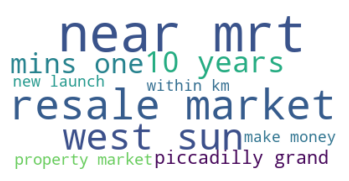

In [29]:
create_wordcloud(topic_model_bi,topic=-1)

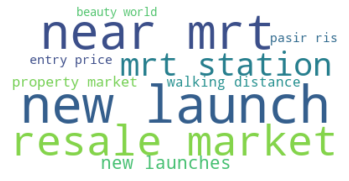

In [30]:
create_wordcloud(topic_model_bi,topic=0)

In [31]:
topic_nr_bi = freq_bi.iloc[1]["Topic"]

In [32]:
topic_nr_bi = freq_bi.iloc[1]["Topic"] # select a frequent topic
topic_model_bi.get_topic(topic_nr_bi)

[('new launch', 0.006945529273993013),
 ('near mrt', 0.006145417839979838),
 ('resale market', 0.005730782529195919),
 ('mrt station', 0.005225792925557276),
 ('new launches', 0.004454436139136721),
 ('property market', 0.004106363015694641),
 ('walking distance', 0.0035647968080408285),
 ('pasir ris', 0.0032468200705892255),
 ('entry price', 0.0030718329976376964),
 ('beauty world', 0.0030518591805153337)]

USE embedding model

In [33]:
# topic_model_bi_2 = BERTopic(embedding_model=embedding_model, min_topic_size=70, n_gram_range=(1,1), verbose=True)
# topics_bi_2, _ = topic_model_bi_2.fit_transform(text)

In [34]:
# freq_bi_2 = topic_model_bi_2.get_topic_info()
# freq_bi_2.head(10)

In [35]:
# create_wordcloud(topic_model_bi_2,topic=0)

In [36]:
# create_wordcloud(topic_model_bi_2,topic=-1)

**Trigram**

In [37]:
# topic_model_tri = BERTopic(min_topic_size=70, n_gram_range=(3,3), verbose=True)
# topics_tri, _ = topic_model_tri.fit_transform(df["join_clean_text"].to_list())

In [38]:
# freq_tri = topic_model_tri.get_topic_info()
# freq_tri.head(10)

In [39]:
# create_wordcloud(topic_model_tri,topic=-1)

In [40]:
# create_wordcloud(topic_model_tri,topic=0)

In [41]:
# topic_nr_tri = freq_tri.iloc[2]["Topic"] # select a frequent topic
# topic_model_tri.get_topic(topic_nr_tri)

In [42]:
# topic_docs = {topic: [] for topic in set(topics_bi)}
# for topic, text in zip(topics_bi, text):
#     topic_docs[topic].append(text)

In [43]:
# text = ''.join([i for i in text if not i.isdigit()])
# text

USE embedding model

In [44]:
# topic_model_tri_2 = BERTopic(embedding_model=embedding_model, min_topic_size=70, n_gram_range=(1,1), verbose=True)
# topics_tri_2, _ = topic_model_tri_2.fit_transform(text)

In [45]:
# freq_tri_2 = topic_model_tri_2.get_topic_info()
# freq_tri_2.head(10)

In [46]:
# create_wordcloud(topic_model_tri_2,topic=0)

In [47]:
# create_wordcloud(topic_model_tri_2,topic=1)

In [48]:
#after

In [49]:
# df = pd.read_csv("aftercovid.csv")

In [50]:
# # topic_model_uni = BERTopic(n_gram_range=(1,1), verbose=True)
# topic_model_uni = BERTopic(n_gram_range=(1,1), verbose=True)
# topics_uni, _ = topic_model_uni.fit_transform(df["join_clean_text"].to_list())
# freq_uni = topic_model_uni.get_topic_info()
# freq_uni.head(10)

In [51]:
# topic_model_bi = BERTopic(min_topic_size=70, n_gram_range=(2,2), verbose=True)
# topics_bi, _ = topic_model_bi.fit_transform(df["join_clean_text"].to_list())
# freq_bi = topic_model_bi.get_topic_info()
# freq_bi.head(10)

In [52]:
# topic_model_tri = BERTopic(min_topic_size=70, n_gram_range=(3,3), verbose=True)
# topics_tri, _ = topic_model_tri.fit_transform(df["join_clean_text"].to_list())
# freq_tri = topic_model_tri.get_topic_info()
# freq_tri.head(10)

# Results


Get docs by topic number

In [53]:
topic_model_bi.get_representative_docs(topic=1)

['abcde83 ah beng school scholars school one many variables influence ur career character important scholars different grades tiers diminishing achievements met lots people going around calling scholars chinese recruited study high school university sg people take random mass recruitment program teachers study nie soldiers saf recruitment program study ntu nus basically low tiered programs guy neighborhood schools life including neighborhood jc university got local honor program must told wife scholar cuz wife bragged scholar today 40 years applied bto friends peers ex schoolmates psc scholars ps',
 'bolster well exceptional type happen rest ah beng school scholars school one many variables influence ur career character important',
 'school much ultimately parents main education seen lot smart students pri secondary strayed tertiary education bcos parents divorced mine included']

List of topics

In [54]:
topic_model_bi.get_topics()

{-1: [('near mrt', 0.011161085462104182),
  ('resale market', 0.007683720453385103),
  ('west sun', 0.006185795048073964),
  ('10 years', 0.006133788689645897),
  ('mins one', 0.0055751790948515975),
  ('piccadilly grand', 0.0054532862671025925),
  ('property market', 0.005228638168755875),
  ('new launch', 0.004993162506785955),
  ('make money', 0.004883994828796314),
  ('within km', 0.004863185357946046)],
 0: [('new launch', 0.006945529273993013),
  ('near mrt', 0.006145417839979838),
  ('resale market', 0.005730782529195919),
  ('mrt station', 0.005225792925557276),
  ('new launches', 0.004454436139136721),
  ('property market', 0.004106363015694641),
  ('walking distance', 0.0035647968080408285),
  ('pasir ris', 0.0032468200705892255),
  ('entry price', 0.0030718329976376964),
  ('beauty world', 0.0030518591805153337)],
 1: [('primary school', 0.03792896140852759),
  ('within 1km', 0.027135280595657514),
  ('primary schools', 0.018648608423220706),
  ('good school', 0.015316458793

In [57]:
topic_model_bi.get_topic_info()

,Topic,Count,Name
0,-1,751,-1_near mrt_resale market_west sun_10 years
1,0,13298,0_new launch_near mrt_resale market_mrt station
2,1,987,1_primary school_within 1km_primary schools_go...
3,2,344,2_fixed rate_interest rate_3m sora_interest rates
4,3,78,3_campaign forumposting_ne arezone_medium utm_...


# Topic prediction

In [ ]:
# topic_list = []
# #probs_list = []
# for doc in text:
#     test_docs = doc
#     predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)
#     topic = topic_model_bi.get_topic(predicted_topics[0])
#     topic_list.append(topic)
#   #probs_list.append(predicted_probs)


In [ ]:
# topic_list

In [ ]:
#probs_list

In [ ]:
# dfs_with_topics = df

In [ ]:
# dfs_with_topics.to_csv('file_name.csv', encoding='utf-8')

In [ ]:
# test_docs = text[0]

In [ ]:
# Predict topics for test_docs
# predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)

In [ ]:
# predicted_topics

In [ ]:
# topic = topic_model_bi.get_topic(predicted_topics[0])
# topic

In [ ]:
# test_docs = text[1]

In [ ]:
# Predict topics for test_docs
# predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)

In [ ]:
# predicted_topics

In [ ]:
# topic = topic_model_bi.get_topic(predicted_topics[0])
# topic

In [ ]:
# test_docs = text[2]

In [ ]:
# Predict topics for test_docs
# predicted_topics, predicted_probs = topic_model_bi.transform(test_docs)

In [ ]:
# predicted_topics

In [ ]:
# topic = topic_model_bi.get_topic(predicted_topics[0])
# topic

# Coherence Score

**Unigram**

In [ ]:
# from bertopic import BERTopic
# import gensim.corpora as corpora
# from gensim.models.coherencemodel import CoherenceModel

# # text = dfs[2].lemmatized.to_list()
# # dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

# topic_model = BERTopic(verbose=True, n_gram_range=(1, 1))
# topics, _ = topic_model.fit_transform(text)

# # Preprocess Documents
# documents = pd.DataFrame({"Document": text,
#                           "ID": range(len(text)),
#                           "Topic": topics})
# documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
# cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# # Extract vectorizer and analyzer from BERTopic
# vectorizer = topic_model.vectorizer_model
# analyzer = vectorizer.build_analyzer()

# # Extract features for Topic Coherence evaluation
# words = vectorizer.get_feature_names()
# tokens = [analyzer(doc) for doc in cleaned_docs]
# dictionary = corpora.Dictionary(tokens)
# corpus = [dictionary.doc2bow(token) for token in tokens]
# topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
#                for topic in range(len(set(topics))-1)]

# # Evaluate
# coherence_model = CoherenceModel(topics=topic_words, 
#                                  texts=tokens, 
#                                  corpus=corpus,
#                                  dictionary=dictionary, 
#                                  coherence='c_v')
# coherence = coherence_model.get_coherence()

In [ ]:
# print(coherence)

**Bigram**

In [58]:
from bertopic import BERTopic
import gensim.corpora as corpora
from gensim.models.coherencemodel import CoherenceModel

# text = dfs[2].lemmatized.to_list()
# dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

topic_model = BERTopic(verbose=True, n_gram_range=(2, 2))
topics, _ = topic_model.fit_transform(text)

# Preprocess Documents
documents = pd.DataFrame({"Document": text,
                          "ID": range(len(text)),
                          "Topic": topics})
documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# Extract vectorizer and analyzer from BERTopic
vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation
words = vectorizer.get_feature_names()
tokens = [analyzer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_v')
coherence = coherence_model.get_coherence()

Batches:   0%|          | 0/484 [00:00<?, ?it/s]

2022-10-25 16:08:48,385 - BERTopic - Transformed documents to Embeddings
2022-10-25 16:08:57,543 - BERTopic - Reduced dimensionality
2022-10-25 16:08:58,550 - BERTopic - Clustered reduced embeddings


In [59]:
print(coherence)

0.7283937216446056


In [60]:
topic_model.get_topic_info()

,Topic,Count,Name
0,-1,7702,-1_new launch_resale market_mrt station_near mrt
1,0,795,0_primary school_within 1km_primary schools_go...
2,1,340,1_fixed rate_interest rate_3m sora_property br...
3,2,240,2_resale flat_open market_hdb resale_accrued i...
4,3,202,3_resale market_low 15xxpsf_15xxpsf jun2018_mr...
...,...,...,...
210,209,11,209_paya lebar_growth areas_areas growth_exten...
211,210,10,210_psf ppr_cost marketing_zhun formula_shows ...
212,211,10,211_type bedder_unit type_check prop_bedder units
213,212,10,212_early birds_birds always_tamp ec_like early


**Trigram**

In [61]:
# from bertopic import BERTopic
# import gensim.corpora as corpora
# from gensim.models.coherencemodel import CoherenceModel

# # text = dfs[2].lemmatized.to_list()
# # dates = dfs[2]['Date'].apply(lambda x: pd.Timestamp(x)).to_list()

# topic_model = BERTopic(verbose=True, n_gram_range=(3, 3))
# topics, _ = topic_model.fit_transform(text)

# # Preprocess Documents
# documents = pd.DataFrame({"Document": text,
#                           "ID": range(len(text)),
#                           "Topic": topics})
# documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
# cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

# # Extract vectorizer and analyzer from BERTopic
# vectorizer = topic_model.vectorizer_model
# analyzer = vectorizer.build_analyzer()

# # Extract features for Topic Coherence evaluation
# words = vectorizer.get_feature_names()
# tokens = [analyzer(doc) for doc in cleaned_docs]
# dictionary = corpora.Dictionary(tokens)
# corpus = [dictionary.doc2bow(token) for token in tokens]
# topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
#                for topic in range(len(set(topics))-1)]

# # Evaluate
# coherence_model = CoherenceModel(topics=topic_words, 
#                                  texts=tokens, 
#                                  corpus=corpus,
#                                  dictionary=dictionary, 
#                                  coherence='c_v')
# coherence = coherence_model.get_coherence()

In [62]:
# print(coherence)

# Visualization


**Intertopic Distance Map**

---



In [63]:
topic_model.visualize_topics()

In [64]:
fig = topic_model.visualize_topics()
fig
# fig.write_html("./drive/MyDrive/Code/topicDistanceMap.html")

**Hierachical Clustering**

---



In [65]:
topic_model.visualize_hierarchy()

**Word scores**

---



In [66]:
topic_model.visualize_barchart()

In [67]:
fig = topic_model.visualize_barchart()
fig
# fig.write_html("./drive/MyDrive/Code/topicWordScores.html")

**Topics over time**

---



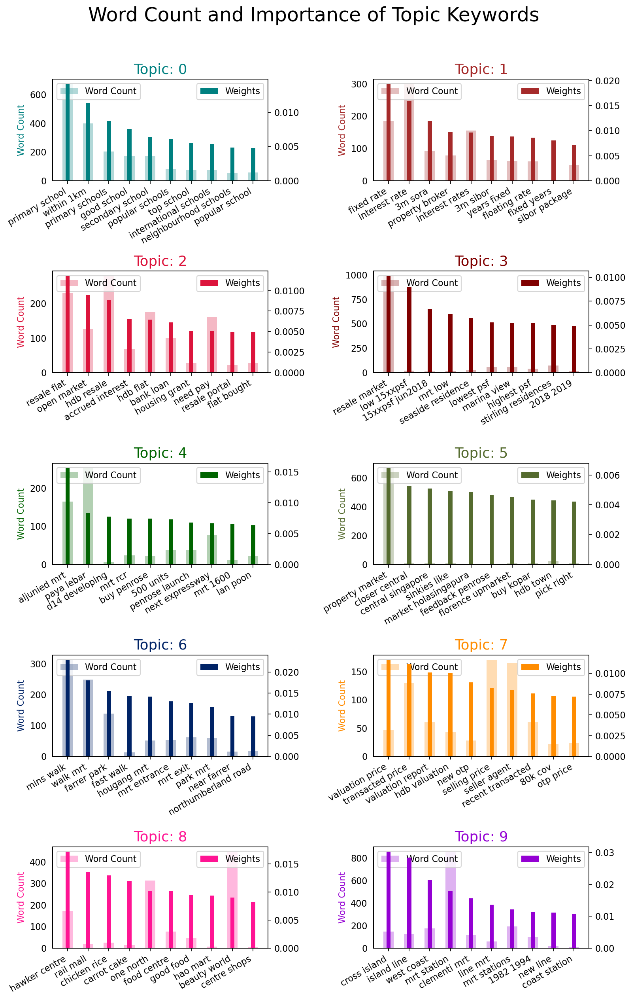

In [68]:
from collections import Counter

topics = topic_model.get_topics()
topics = {k:topics[k] for k in (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20) if k in topics}
data_flat = [w for w_list in data_lemmatized for w in w_list]
counter = Counter(data_flat)
ntopics_des_name = 10

out = []
for i, topic in topics.items():
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df_word = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(5,2, figsize=(10,15), dpi=160,facecolor='white')
cols = ['#008080', '#A52A2A', '#DC143C', '#800000', '#006400', '#556b2f', '#002366', '#ff8c00', '#FF1493', '#9400D3',
        '#ba55d3', '#b8860b', '#C71585', '#00ff7f', '#00004C', '#00008B', '#B8860B', '#DEB887', '#8A2BE2', '#1b364a']

for i, ax in enumerate(axes.flatten()):
    if i > ntopics_des_name - 1: # break when all topics are shown
        break
    ax.bar(x='word', height="word_count", data=df_word.loc[df_word.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df_word.loc[df_word.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df_word.loc[df_word.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')


fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)    
plt.savefig('bert_topics_after_bigram.png',facecolor=fig.get_facecolor(), transparent=True)
plt.show()

